In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')

In [2]:
data=pd.read_csv('listings.csv.gz')

In [3]:
data.neighbourhood_group_cleansed.unique() #all values are equal to nan so we can delete this column 

array([nan])

In [4]:
data.neighbourhood_cleansed.nunique()

20

In [5]:
data.neighbourhood_cleansed.value_counts()   #No missing values in this column

Buttes-Montmartre      7474
Popincourt             6459
Vaugirard              4977
Entrepôt               4628
Batignolles-Monceau    4494
Ménilmontant           3825
Buttes-Chaumont        3813
Passy                  3267
Opéra                  3235
Temple                 3090
Reuilly                2731
Observatoire           2548
Gobelins               2330
Bourse                 2286
Panthéon               2198
Hôtel-de-Ville         2009
Luxembourg             1958
Palais-Bourbon         1829
Élysée                 1789
Louvre                 1394
Name: neighbourhood_cleansed, dtype: int64

In [6]:
data.host_neighbourhood.isna().sum()

14468

In [7]:
data.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [8]:
data[data.property_type=="Island"]

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
43915,32991493,https://www.airbnb.com/rooms/32991493,20201012032825,2020-10-12,Paris Iles Saint Louis Loft,Beautiful 2 story Loft in the middle of a Pari...,"Honestly, the most beautiful area of Paris. Ri...",https://a0.muscache.com/pictures/523f555d-06c2...,43099452,https://www.airbnb.com/users/show/43099452,...,10.0,10.0,6.0,NaN,t,1,1,0,0,0.21


In [9]:
data["price"]=data["price"].str.replace("$","").str.replace(",","").astype(float)

# <FONT COLOR="Red">Number of listing by neighbourhood</font>

In [10]:
Number_by_neighbourhood=data.groupby("neighbourhood").size().sort_values(ascending=False)

In [11]:
Number_by_neighbourhood[Number_by_neighbourhood>20]

neighbourhood
Paris, Île-de-France, France                       36633
Paris, France                                       1035
Paris, IDF, France                                   450
Paris, Île-de-France Region, France                  214
Paris, Ile-de-France, France                          85
Paris-18E-Arrondissement, Île-de-France, France       58
Paris-20E-Arrondissement, Île-de-France, France       55
Paris 18e, France                                     55
Paris-15E-Arrondissement, Île-de-France, France       48
Paris-19E-Arrondissement, Île-de-France, France       47
Paris, Paris province, France                         47
Paris-11E-Arrondissement, Île-de-France, France       41
Paris-13E-Arrondissement, Île-de-France, France       38
Paris, 75, France                                     38
Paris 15e, France                                     37
Paris 10e, France                                     35
Paris-5E-Arrondissement, Île-de-France, France        32
Paris 14e, France

On peut constater que la plupart des logements n'ont pas un emplacement bien préci ( 36633 logements avec "Paris, Ile de France, France"). Aprés avoir exploré les données, j'ai constaté que la colonne "neighbourhood_cleansed" permet d'avoir l'arrondissement où se trouve le logement. \
Le tableau ci-dessous détermines les noms des arrondissementsd'aprés wikipedia:

| Numéro d'arrondissement |        Nom       |
|-------------------------|:----------------:|
|            1            |      Louvre      |
|            2            |      Bourse      |
|            3            |      Temple      |
|            4            |  Hôtel-de-ville  |
|            5            |     Panthéon     |
|            6            |    Luxembourg    |
|            7            |  Palais-Bourbon  |
|            8            |      Elysée      |
|            9            |       Opéra      |
|            10           |     Entrepôt     |
|            11           |    Popincourt    |
|            12           |      Reuilly     |
|            13           |     Gobelins     |
|            14           |   Observatoire   |
|            15           |   Vaugirard             |
|            16           |   Passy                 |
|            17           |   Batignolles-Monceau   |
|            18           |   Buttes-Montmartre   |
|            19           |   Buttes-Chaumont   |
|            20           |   Ménilmontant    |

L'idée donc sera de créer une autre colonne qui contiendra l'emplacement précis des logements:

In [12]:
keys=data.neighbourhood_cleansed.unique()
values=np.array([10,14,11,3,4,9,1,18,8,13,6,19,5,7,12,2,20,15,17,16])
zip_values=zip(keys,values)
dict_=dict(zip_values)


In [13]:
data['Arrondissement']=data['neighbourhood_cleansed'].apply(lambda x: 'Arrondissement_' + str(dict_[x]))    

In [14]:
#On peut vérifier avec des exemples:
data[data["neighbourhood"] == "Paris-12E-Arrondissement, Île-de-France, France"].loc[:, ["neighbourhood","Arrondissement"]].head(10)

,neighbourhood,Arrondissement
12628,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
12833,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
12998,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
14804,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
15104,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
15513,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
16014,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
16050,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
16054,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12
16867,"Paris-12E-Arrondissement, Île-de-France, France",Arrondissement_12


On peut constater que le nombre des logements qui se situent dans le banlieue parisienne est petit. On ne va pas donc les prendre en considération. 


In [15]:
Number_by_neighbourhood=data[(data.neighbourhood.str.lower().str.contains('paris')==False) & (data.neighbourhood.str.lower().str.contains('parís')==False)& (data.neighbourhood.str.lower().str.contains('arrondissement')==False) & (data.neighbourhood.str.lower().str.contains('district')==False)].groupby("neighbourhood").size().sort_values(ascending=False)
Number_by_neighbourhood

neighbourhood
Neuilly-sur-Seine, Île-de-France, France       27
Boulogne-Billancourt, Île-de-France, France    19
Clichy, Île-de-France, France                  19
Levallois-Perret, Île-de-France, France        18
Gentilly, Île-de-France, France                15
Issy-les-Moulineaux, Île-de-France, France     14
Vincennes, Île-de-France, France               12
Saint-Mandé, Île-de-France, France             11
Montrouge, Île-de-France, France                9
Saint-Ouen, Île-de-France, France               9
Pantin, Île-de-France, France                   9
Le Pré-Saint-Gervais, Île-de-France, France     8
Ivry-sur-Seine, Île-de-France, France           6
Charenton-le-Pont, Île-de-France, France        5
Aubervilliers, Île-de-France, France            5
Bagnolet, Île-de-France, France                 5
Vanves, Île-de-France, France                   4
Les Lilas, Île-de-France, France                4
Île-de-France, France                           4
Nogent-sur-Marne, Île-de-France, Fra

In [16]:
logements_paris=data[(data.neighbourhood.str.lower().str.contains('paris')==True) | (data.neighbourhood.str.lower().str.contains('parís')==True) | (data.neighbourhood.str.lower().str.contains('arrondissement')==True) | (data.neighbourhood.str.lower().str.contains('district')==True)]

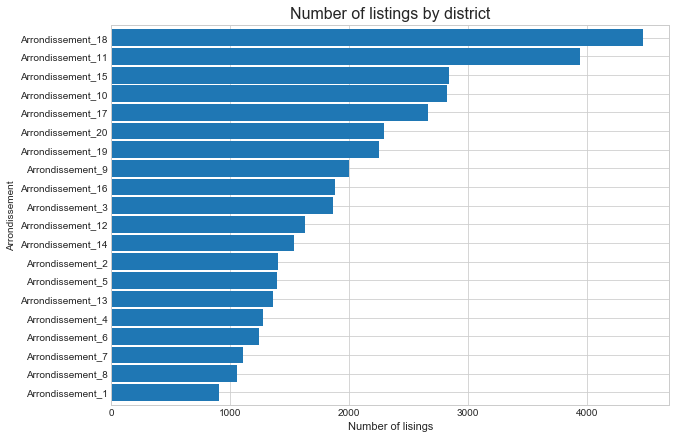

In [17]:
fig, ax = plt.subplots()
plt.title('Number of listings by district',size=16,)
plt.xlabel("Number of lisings", size = 11,)
logements_paris.groupby('Arrondissement').size().sort_values(ascending=True).plot(kind='barh',ax=ax, figsize=(10,7), width=0.9)

# <FONT COLOR="Red">Property types in Paris</font>

In [18]:
logements_paris.loc[:,'property_type']=logements_paris.loc[:,"property_type"].str.replace("Entire ","").str.replace("Private room in ","").str.replace("Room in ","").str.replace("Shared room in ","")

C:\Users\lamyae\AppData\Local\Continuum\anaconda3\envs\IA\lib\site-packages\pandas\core\indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


In [19]:
crosstab=pd.crosstab(index=logements_paris['property_type'], columns=logements_paris['room_type'])

In [20]:
property_type=logements_paris.set_index("room_type").groupby("property_type").size().sort_values(ascending=True)

In [21]:
property_type=property_type[property_type>40]
a=property_type.index


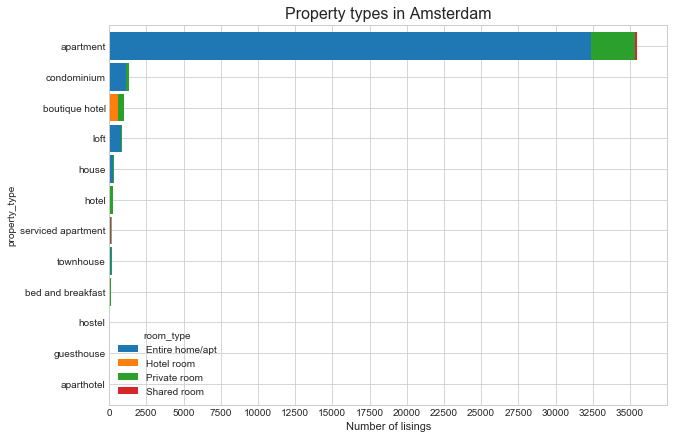

In [22]:
fig, ax = plt.subplots()
plt.title('Property types in Amsterdam',size=16,)
plt.xlabel("Number of lisings", size = 11,)
plt.xlim([0, 37500])
plt.xticks(np.arange(0, 37500, 2500))
crosstab.loc[a,:].plot.barh(stacked=True, ax=ax, figsize=(10,7),width=0.9)

# <FONT COLOR="Red">Accommodates (number of people)</font>

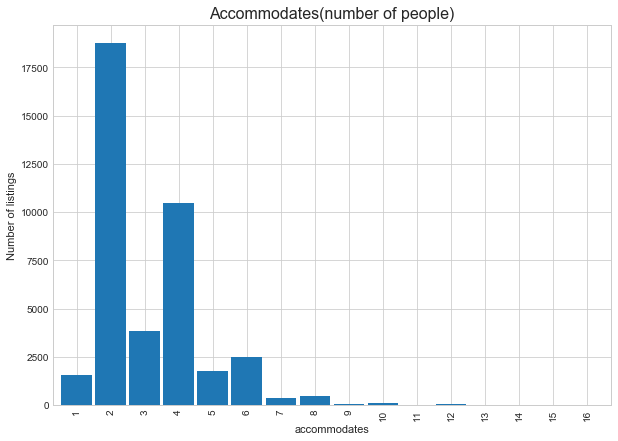

In [23]:
fig, ax = plt.subplots()
plt.title('Accommodates(number of people)',size=16,)
plt.xlabel("Accommodates", size = 11,)
plt.ylabel("Number of listings", size = 11,)
plt.xlim([1, 15])
plt.xticks(np.arange(1, 15, 1))
logements_paris.groupby('accommodates').size().plot(kind='bar',ax=ax, figsize=(10,7),width=0.9)

# <FONT COLOR="Red">Average daily price for a 2-persons accommodation</font>

D'aprés le site airbnb, les prix sont en euros:

In [24]:
logements_paris.loc[:,["listing_url","price"]].head(5)

,listing_url,price
1,https://www.airbnb.com/rooms/3109,60.0
2,https://www.airbnb.com/rooms/4886,89.0
3,https://www.airbnb.com/rooms/4890,103.0
4,https://www.airbnb.com/rooms/5396,48.0
8,https://www.airbnb.com/rooms/9952,75.0


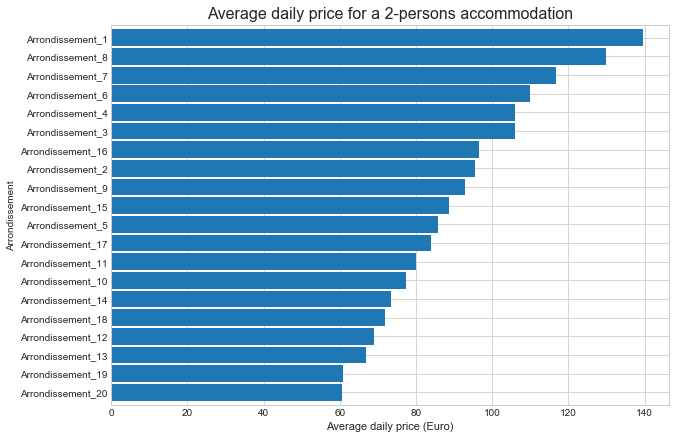

In [25]:
fig, ax = plt.subplots()
plt.title('Average daily price for a 2-persons accommodation',size=16,)
plt.xlabel("Average daily price (Euro)", size = 11,)
logements_paris[logements_paris.accommodates==2].groupby("Arrondissement")["price"].mean().sort_values(ascending=True).plot(kind='barh',ax=ax, figsize=(10,7),width=0.9)

# <FONT COLOR="Red">Interactive map with the numbers of listings as markerclusters</font>

In [26]:
import os
import folium
from folium import plugins
print(folium.__version__)

0.11.0


In [27]:
logements_paris.latitude.isna().sum()   #no missing values

0

In [28]:
logements_paris.longitude.isna().sum()     #no missing values

0

In the map below, I am only representing locations in Paris ( I didn't represent location in subrubs). As we can see, most listings are in the 18 and 11 district. 

In [29]:
center = [48.862, 2.346]
paris = folium.Map(center, zoom_start=12)
latitudes = np.array(logements_paris.latitude)
longitudes=np.array(logements_paris.longitude)
data_=np.array([latitudes,longitudes]).T
plugins.MarkerCluster(data_).add_to(paris)
paris

In the map below, I am displaying locations in Paris and in subrubs ( I didn't represent location in subrubs)

In [30]:
center = [48.862, 2.346]
paris_subrubs = folium.Map(center, zoom_start=12.1)
latitudes = np.array(data.latitude)
longitudes=np.array(data.longitude)
data_=np.array([latitudes,longitudes]).T
plugins.MarkerCluster(data_).add_to(paris_subrubs)
paris_subrubs

# <FONT COLOR="Red">Interactive map with the average price for 2-persons accommodations for each district</font>

In the map below, we can see that the price is high in the distrints of the center of paris.

In [31]:
from pandas.io.json import json_normalize
import re
import geopandas
df = geopandas.read_file("arrondissements.geojson")
df['Arrondissement']=df['l_ar'].apply(lambda x : 'Arrondissement_' + re.findall('\d+', x)[0] )

In [32]:
price=pd.DataFrame([logements_paris[logements_paris.accommodates==2].groupby("Arrondissement")["price"].mean().sort_values(ascending=True)]).T
df=pd.merge(df, price, on='Arrondissement', how='left')
df.price=df.price.astype(int)
dict_=dict(zip(df.Arrondissement,df.price))
dict_=dict(sorted(dict_.items(), key=lambda item: item[1]))
a=np.unique(np.array([value for value in dict_.values()]))

In [33]:
from matplotlib import cm
orRd = cm.get_cmap('OrRd', len(a))

In [34]:
e=df.to_json()

In [35]:
import matplotlib
center = [48.862, 2.346]
paris2 = folium.Map(center, zoom_start=12)
folium.GeoJson(e,
               tooltip=folium.features.GeoJsonTooltip(fields=['Arrondissement', 'price'],
                                                      labels=True,
                                                      sticky=False),
               style_function= lambda feature: {
                   'fillColor': matplotlib.colors.to_hex(orRd(np.where(a==feature['properties']['price']))[0][0]),
                   'color': 'black',
                   'weight': 2,
                   'dashArray': '5, 5',
                   'fillOpacity':0.5
                   }).add_to(paris2)


In [36]:
paris2

# <FONT COLOR="Red">Number of listings available by date</font>


In [37]:
calendar=pd.read_csv('calendar.csv.gz')

In [38]:
calendar

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,2577,2020-10-19,f,$125.00,$125.00,3.0,1125.0
1,73533,2020-10-20,t,$95.00,$95.00,2.0,1125.0
2,73533,2020-10-21,t,$95.00,$95.00,2.0,1125.0
3,73533,2020-10-22,t,$95.00,$95.00,2.0,1125.0
4,73533,2020-10-23,t,$95.00,$95.00,2.0,1125.0
...,...,...,...,...,...,...,...
24214657,45493044,2021-10-10,t,$162.00,$162.00,2.0,999.0
24214658,45493044,2021-10-11,t,$162.00,$162.00,2.0,999.0
24214659,45493044,2021-10-12,t,$162.00,$162.00,2.0,999.0
24214660,45493044,2021-10-13,t,$162.00,$162.00,2.0,999.0


Normally, we shous have 2020 instead of 2021!!

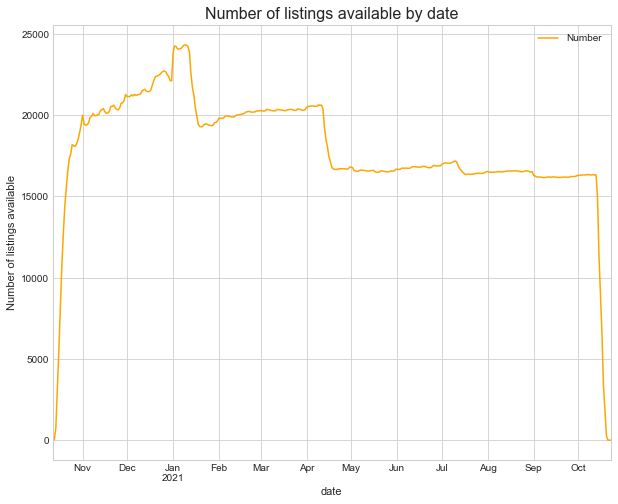

In [39]:
calendar['date']=pd.to_datetime(calendar['date'])
available = calendar[calendar.available == "t"].groupby(['date']).size().to_frame(name= 'Number').reset_index()
available['day'] = available['date'].dt.day_name()
available = available.set_index('date')
fig, ax = plt.subplots()
plt.title('Number of listings available by date',size=16,)
plt.xlabel("Date", size = 11,)
plt.ylabel("Number of listings available", size = 11,)
available.plot(y='Number', kind = 'line',figsize=(10,8),ax=ax, color="orange")

In [40]:
available['2021-10':'2021-11']

,Number,day
date,,
2021-10-01,16301,Friday
2021-10-02,16296,Saturday
2021-10-03,16320,Sunday
2021-10-04,16323,Monday
2021-10-05,16328,Tuesday
2021-10-06,16331,Wednesday
2021-10-07,16336,Thursday
2021-10-08,16347,Friday
2021-10-09,16326,Saturday


Since the number of listings is very low from 2020-10-18,I decided to remove dates after this date. 

In [41]:
calendar = calendar[calendar.date < '2021-10-18']

C:\Users\lamyae\AppData\Local\Continuum\anaconda3\envs\IA\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


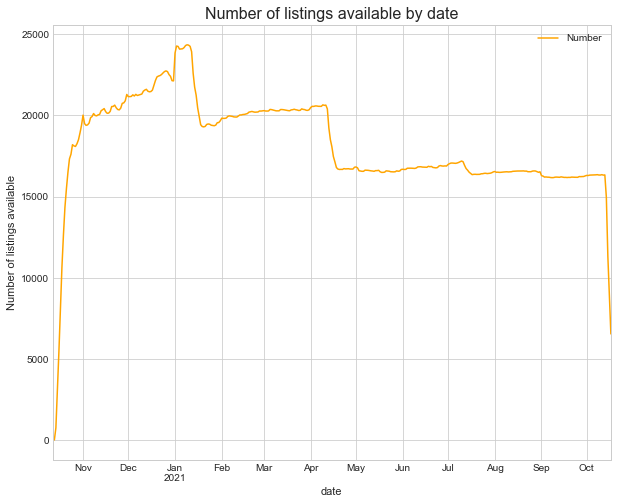

In [42]:
calendar['date']=pd.to_datetime(calendar['date'])
available = calendar[calendar.available == "t"].groupby(['date']).size().to_frame(name= 'Number').reset_index()
available['day'] = available['date'].dt.day_name()
available = available.set_index('date')
fig, ax = plt.subplots()
plt.title('Number of listings available by date',size=16,)
plt.xlabel("Date", size = 11,)
plt.ylabel("Number of listings available", size = 11,)
available.plot(y='Number', kind = 'line',figsize=(10,8),ax=ax, color="orange")

# <FONT COLOR="Red">Average price of available 2 persons accomodation by date</font>

In [43]:
data.rename(columns = {'id': 'listing_id'},inplace=True)
calendar = pd.merge(calendar, data[['listing_id','accommodates']], on = "listing_id", how = "left")

In [44]:
calendar.accommodates.isna().sum()

0

In [45]:
calendar["price"]=calendar["price"].str.replace("$","").str.replace(",","").astype(float)

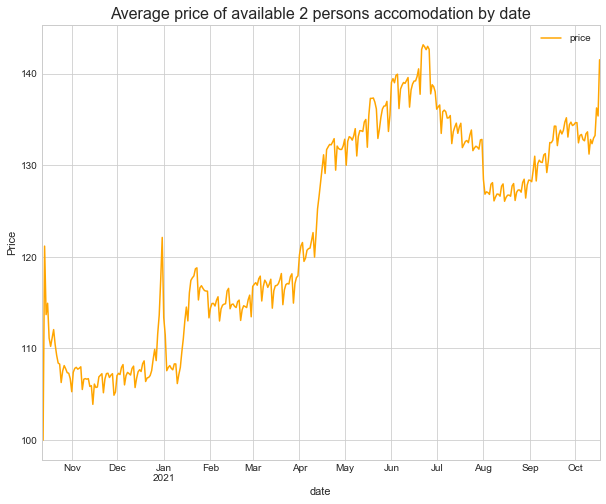

In [46]:
price=calendar[(calendar.available == "t") & (calendar.accommodates == 2)].groupby(['date']).mean().reset_index()
price['day'] = price['date'].dt.day_name()
price = price.set_index('date')
fig, ax = plt.subplots()
plt.title('Average price of available 2 persons accomodation by date',size=16,)
plt.xlabel("Date", size = 11,)
plt.ylabel("Price", size = 11,)
price.plot(y='price', kind = 'line',figsize=(10,8),ax=ax, color="orange")
